In [ ]:
!pip install pandas-profiling==2.7.1

     |████████████████████████████████| 252 kB 7.1 MB/s 
     |████████████████████████████████| 4.7 MB 44.6 MB/s 
     |████████████████████████████████| 58 kB 5.9 MB/s 
     |████████████████████████████████| 675 kB 56.8 MB/s 
     |████████████████████████████████| 812 kB 60.2 MB/s 
     |████████████████████████████████| 38.2 MB 25 kB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=8f8ca27c0bda196af21d54c2e332361c71f82ef0d288d6b7ed3c9a1684dff075
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d250ba868768823940c3229e9950d201a26d0bd3ee8655
  Created wheel for imagehash: filename=ImageHash-4.2.1-py2.py3-none-any.whl size=295207 sha256=557b68bceab1f81493b59576d426c1c848cf2c37f249942ff94538aada104e99
  Stored in directory: /root/.cache/pip/wheels/4c/d5/59/5e3e297533ddb09407769762985d134135064c6831e29a914e
Successfully built htmlmin imagehash
  Attempting uninstall: scipy
    Found existing installation: scipy 1.4.1
    Uninstalling

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import  StandardScaler
from sklearn.linear_model import Ridge,Lasso,RidgeCV,LassoCV,ElasticNet,ElasticNetCV,LogisticRegression
from sklearn.model_selection import train_test_split
#from statsmodel.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import accuracy_score,confusion_matrix,roc_curve,roc_auc_score
import matplotlib.pyplot as plt
from pandas_profiling import ProfileReport
import seaborn as sns
import pickle

In [ ]:
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/diabetes.csv")

In [ ]:
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [ ]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/21 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
df['BMI']=df['BMI'].replace(0,df['BMI'].mean())

In [ ]:
df.columns

Index(['Pregnancies', 'Glucose', 'BloodPressure', 'SkinThickness', 'Insulin',
       'BMI', 'DiabetesPedigreeFunction', 'Age', 'Outcome'],
      dtype='object')

In [ ]:
df['BloodPressure']=df['BloodPressure'].replace(0,df['BMI'].mean())

In [ ]:
df['Insulin']=df['Insulin'].replace(0,df['Insulin'].mean())

In [ ]:
df['Glucose']=df['Glucose'].replace(0,df['Glucose'].mean())

In [ ]:
df['SkinThickness']=df['SkinThickness'].replace(0,df['SkinThickness'].mean())

In [ ]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/21 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

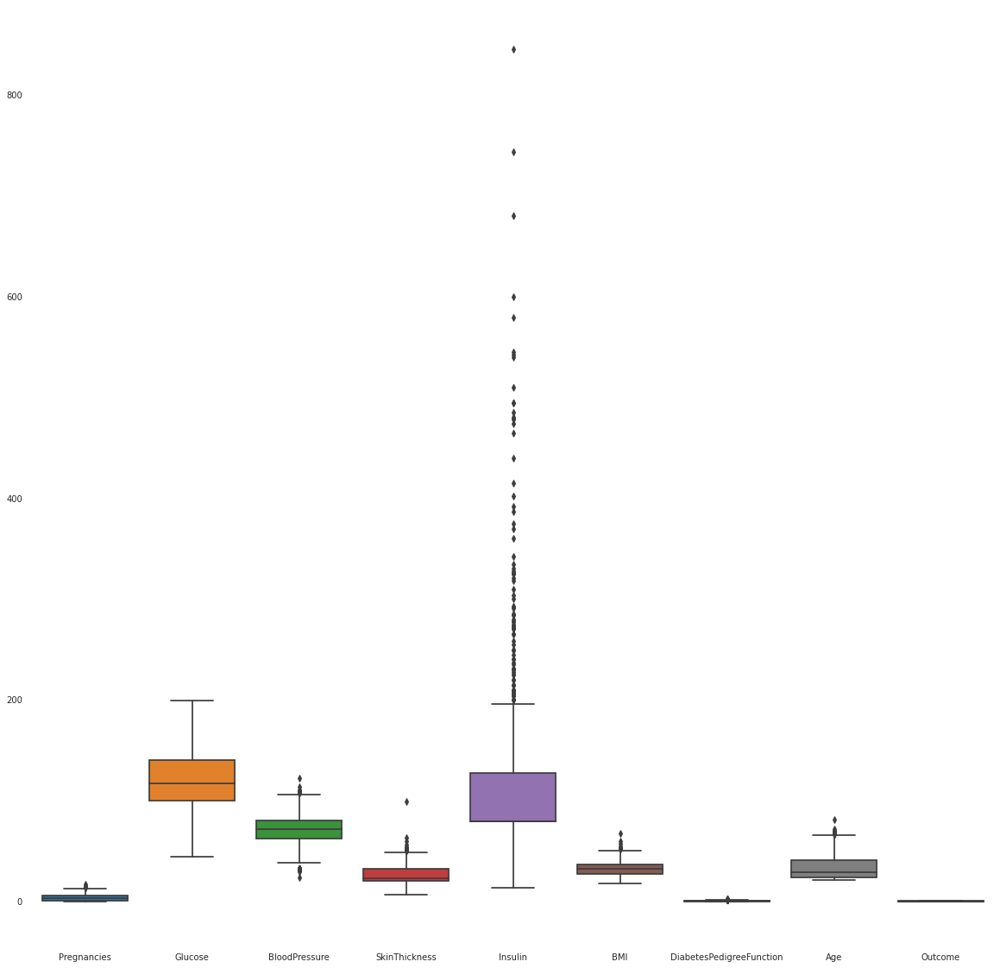

In [ ]:
fig ,ax  = plt.subplots(figsize = (20,20))
sns.boxplot(data = df , ax = ax)

In [ ]:
q = df['Pregnancies'].quantile(.98)
df_new = df[df['Pregnancies'] < q]

q = df_new['BMI'].quantile(.99)
df_new = df_new[df_new['BMI']< q]

q = df_new['SkinThickness'].quantile(.99)
df_new = df_new[df_new['SkinThickness']< q]

q = df_new['Insulin'].quantile(.95)
df_new = df_new[df_new['Insulin']< q]

q = df_new['DiabetesPedigreeFunction'].quantile(.99)
df_new = df_new[df_new['DiabetesPedigreeFunction']< q]


q = df_new['Age'].quantile(.99)
df_new = df_new[df_new['Age']< q]

In [ ]:
def outlier_removal(self,data):
        def outlier_limits(col):
            Q3, Q1 = np.nanpercentile(col, [75,25])
            IQR= Q3-Q1
            UL= Q3+1.5*IQR
            LL= Q1-1.5*IQR
            return UL, LL

        for column in data.columns:
            if data[column].dtype != 'int64':
                UL, LL= outlier_limits(data[column])
                data[column]= np.where((data[column] > UL) | (data[column] < LL), np.nan, data[column])

        return data

In [ ]:
df_new


,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
763,10,101.0,76.0,48.000000,180.000000,32.9,0.171,63,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


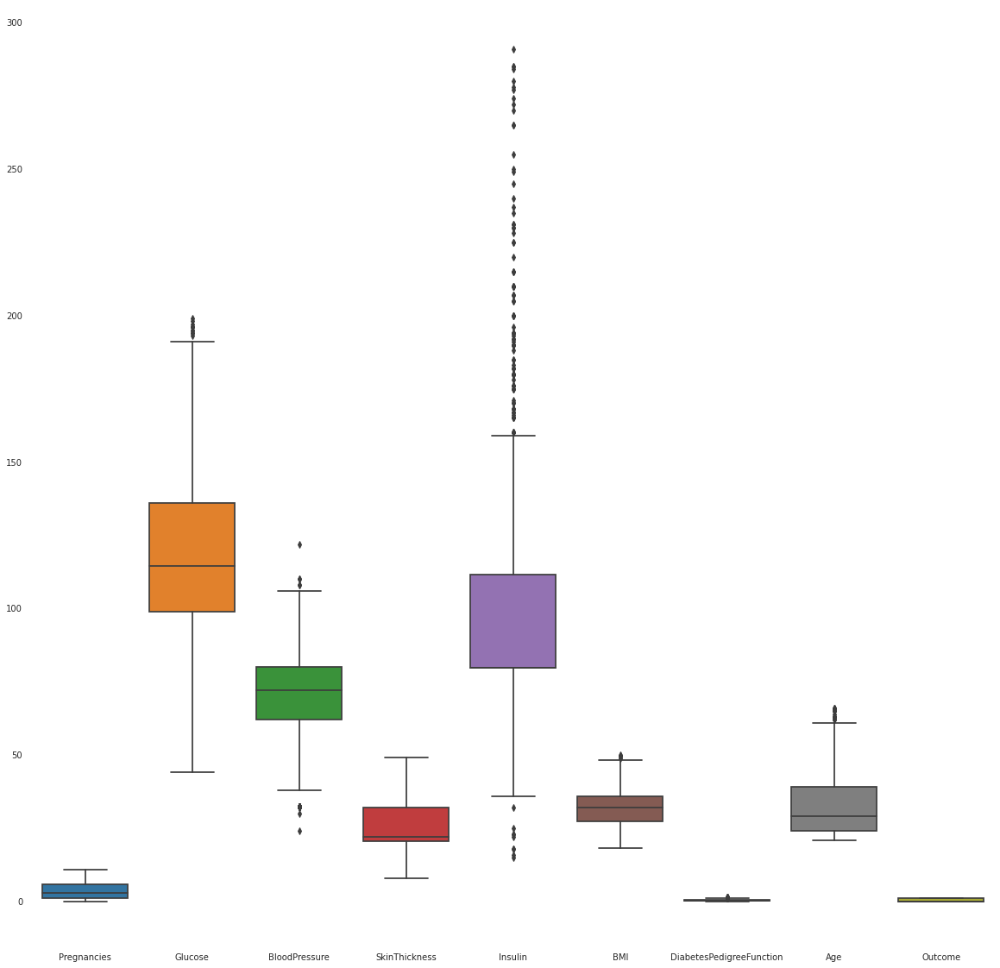

In [ ]:
fig ,ax  = plt.subplots(figsize = (20,20))
sns.boxplot(data = df_new , ax = ax)

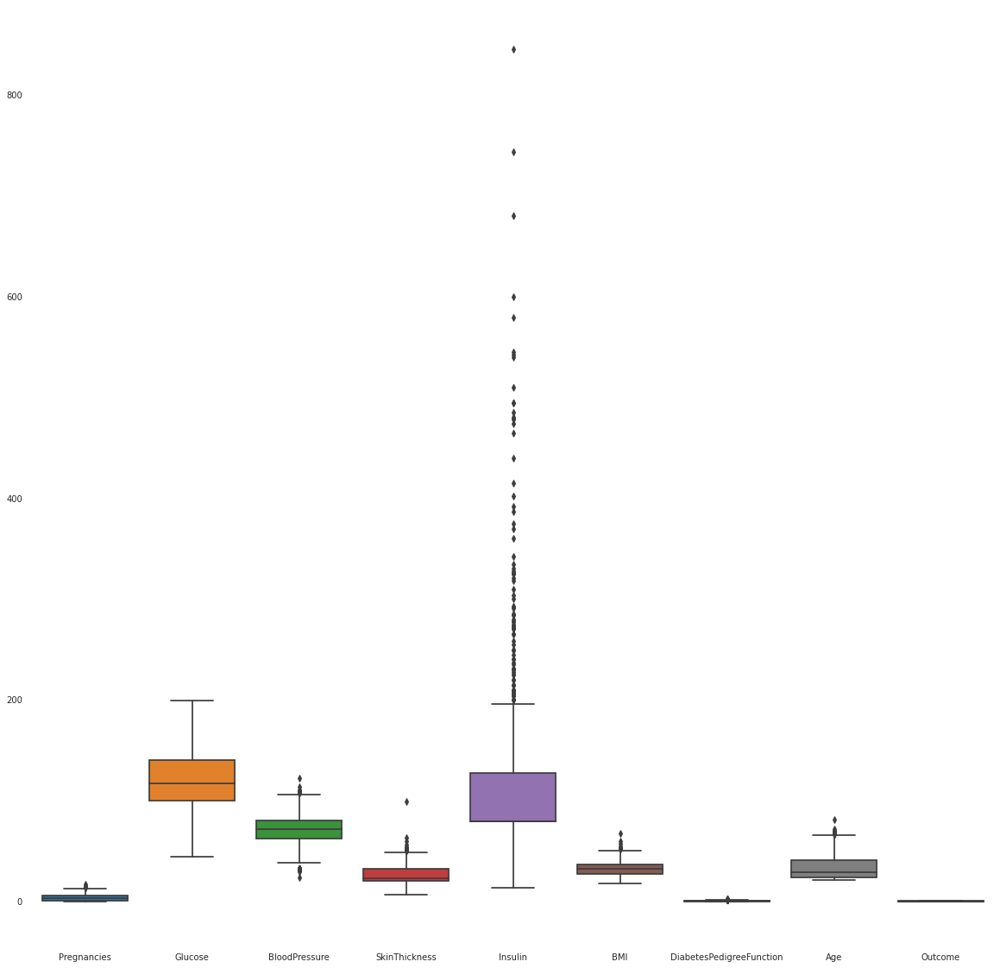

In [ ]:
fig ,ax  = plt.subplots(figsize = (20,20))
sns.boxplot(data = df , ax = ax)

In [ ]:
ProfileReport(df_new)

Summarize dataset:   0%|          | 0/22 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
y = df_new['Outcome']
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 674, dtype: int64

In [ ]:
X = df_new.drop(columns=['Outcome'])

In [ ]:
scalar=StandardScaler()
ProfileReport(pd.DataFrame(scalar.fit_transform(X)))
X_scaled=scalar.fit_transform(X)

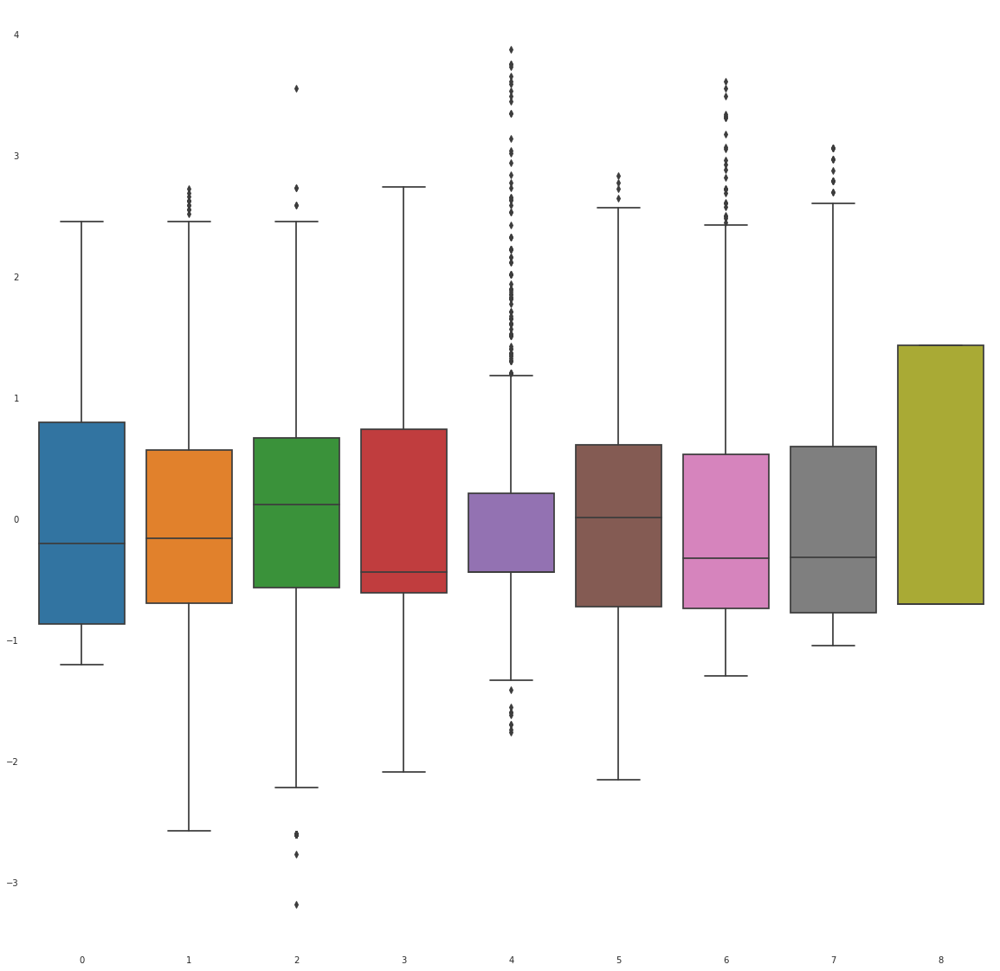

In [ ]:
df_new_scalar = pd.DataFrame(scalar.fit_transform(df_new))
fig ,ax  = plt.subplots(figsize = (20,20))
sns.boxplot(data = df_new_scalar , ax = ax)

In [ ]:
X_scaled

array([[ 0.79675391,  0.98398406,  0.11988668, ...,  0.26581965,
         0.63048454,  1.60141519],
       [-0.86479354, -1.16977621, -0.29217548, ..., -0.83144504,
        -0.33807867, -0.13270648],
       [ 1.46137289,  2.18051755, -0.42952954, ..., -1.34872696,
         0.78840246, -0.04143692],
       ...,
       [ 0.46444442,  0.06094395,  0.11988668, ..., -0.89414587,
        -0.71006309, -0.22397605],
       [-0.86479354,  0.2318773 , -0.70423765, ..., -0.28281269,
        -0.34509724,  1.3276065 ],
       [-0.86479354, -0.89628284, -0.01746738, ..., -0.23578706,
        -0.464413  , -0.86286298]])

In [ ]:
y

0      1
1      0
2      1
3      0
5      0
      ..
763    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 674, dtype: int64

In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
def vif_score(x):
    scaler = StandardScaler()
    arr = scaler.fit_transform(x)
    return pd.DataFrame([[x.columns[i], variance_inflation_factor(arr,i)] for i in range(arr.shape[1])], columns=["FEATURE", "VIF_SCORE"])

In [ ]:
vif_score(X)

,FEATURE,VIF_SCORE
0,Pregnancies,1.448501
1,Glucose,1.293881
2,BloodPressure,1.200215
3,SkinThickness,1.479931
4,Insulin,1.265336
5,BMI,1.466816
6,DiabetesPedigreeFunction,1.041673
7,Age,1.650721


In [ ]:
x_train,x_test,y_train,y_test=train_test_split(X_scaled,y,test_size=0.20,random_state=144)

In [ ]:
x_train

array([[-0.86479354,  0.19769063, -1.39100792, ...,  0.21879402,
         1.80609569, -0.40651517],
       [ 2.45830136,  1.22329076,  0.39459479, ...,  0.21879402,
         3.1782269 ,  1.69268475],
       [ 0.13213493,  0.91561072,  1.01268803, ..., -0.47091521,
        -0.90658316, -0.49778473],
       ...,
       [-0.86479354, -0.28092276,  1.08136506, ..., -0.28281269,
        -1.06801036, -0.86286298],
       [ 1.46137289,  0.02675728,  0.53194884, ..., -1.08224839,
        -0.13454002,  2.87918905],
       [-0.86479354, -0.75953616, -0.15482143, ..., -0.73739378,
         2.27283086, -0.95413254]])

In [ ]:
y_train

356    1
259    1
69     0
407    0
657    0
      ..
734    0
485    1
249    0
509    0
416    0
Name: Outcome, Length: 539, dtype: int64

In [ ]:
logr_liblinear=LogisticRegression(verbose=1,solver='liblinear')

In [ ]:
logr_liblinear.fit(x_train,y_train)

[LibLinear]

LogisticRegression(solver='liblinear', verbose=1)

In [ ]:
logr_liblinear.predict([x_test[0]])

array([0])

In [ ]:
logr_liblinear.predict_proba([x_test[0]])

array([[0.83592503, 0.16407497]])

In [ ]:
logr_liblinear.predict_log_proba([x_test[0]])

array([[-0.17921635, -1.80743179]])

In [ ]:
y_test.iloc[1]

0

In [ ]:
logr=LogisticRegression(verbose=1)

In [ ]:
logr.fit(x_train,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


LogisticRegression(verbose=1)

In [ ]:
logr_liblinear

LogisticRegression(solver='liblinear', verbose=1)

In [ ]:
y_pred_liblinear = logr_liblinear.predict(x_test)
y_pred_liblinear

array([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0])

In [ ]:
y_pred_default = logr.predict(x_test)
y_pred_default

array([0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1,
       1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0])

In [ ]:
confusion_matrix(y_test,y_pred_liblinear)

array([[76, 11],
       [24, 24]])

In [ ]:
confusion_matrix(y_test,y_pred_default)

array([[77, 10],
       [25, 23]])

In [ ]:
def model_eval(y_true,y_pred):
  tn,fp,fn,tp=confusion_matrix(y_test,y_pred).ravel()
  accuracy=(tp+tn)/(tp+tn+fp+fn)
  precision=tp/(tp+fn)
  recall=tp/(tp+fn)
  specificity=tn/(fp+tn)
  F1_Score=2*(recall* precision)/(recall + precision)
  result={"Accuracy":accuracy ,"Precision": precision,"Recalll":recall,"Specificity":specificity,'F1':F1_Score}
  return result
model_eval(y_test,y_pred_liblinear)

{'Accuracy': 0.7407407407407407,
 'F1': 0.5,
 'Precision': 0.5,
 'Recalll': 0.5,
 'Specificity': 0.8735632183908046}

In [ ]:
def model_eval(y_true,y_pred):
  tn,fp,fn,tp=confusion_matrix(y_test,y_pred).ravel()
  accuracy=(tp+tn)/(tp+tn+fp+fn)
  precision=tp/(tp+fn)
  recall=tp/(tp+fn)
  specificity=tn/(fp+tn)
  F1_Score=2*(recall* precision)/(recall + precision)
  result={"Accuracy":accuracy ,"Precision": precision,"Recalll":recall,"Specificity":specificity,'F1':F1_Score}
  return result
model_eval(y_test,y_pred_default)

{'Accuracy': 0.7407407407407407,
 'F1': 0.4791666666666667,
 'Precision': 0.4791666666666667,
 'Recalll': 0.4791666666666667,
 'Specificity': 0.8850574712643678}

In [ ]:
auc = roc_auc_score(y_test,y_pred_liblinear)

In [ ]:
fpr, tpr, thresholds  = roc_curve(y_test,y_pred_liblinear)

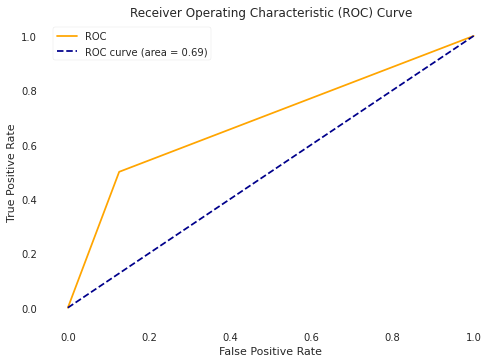

In [ ]:
plt.plot(fpr, tpr, color='orange', label='ROC')
plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--',label='ROC curve (area = %0.2f)' % auc)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()

In [ ]:
auc_default = roc_auc_score(y_test,y_pred_default)

In [ ]:
fpr1, tpr1, thresholds1  = roc_curve(y_test,y_pred_default)

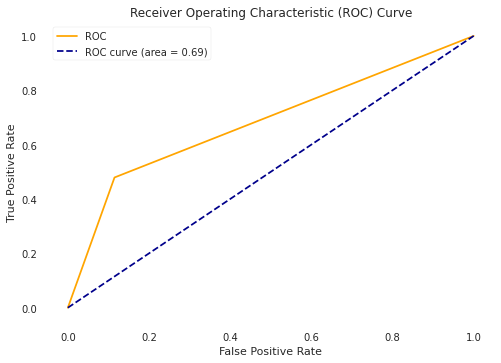

In [ ]:
plt.plot(fpr1, tpr1, color='orange', label='ROC')
plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--',label='ROC curve (area = %0.2f)' % auc)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend()
plt.show()